# Enhancing E-Commerce Strategies Through Customer Behavior Analysis
<span style="font-size:20px;"> - Amisha Kelkar, Arundhati (Ari) Kolahal, Chaitali Deshmukh, Neha Shastri

## Anomaly Detection and Principal Component Analysis (PCA)

### Importing Relevant Libraries

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import matplotlib.pyplot as plt
import statsmodels.api as sm
import plotly.graph_objects as go
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.ensemble import IsolationForest
!pip install psynlig
from psynlig import (pca_explained_variance, pca_explained_variance_bar,)


In [ ]:
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

### Loading the Dataset

In [ ]:
events = pd.read_csv('events.csv')
events.info(show_counts=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2756101 entries, 0 to 2756100
Data columns (total 5 columns):
 #   Column         Non-Null Count    Dtype  
---  ------         --------------    -----  
 0   timestamp      2756101 non-null  int64  
 1   visitorid      2756101 non-null  int64  
 2   event          2756101 non-null  object 
 3   itemid         2756101 non-null  int64  
 4   transactionid  22457 non-null    float64
dtypes: float64(1), int64(3), object(1)
memory usage: 105.1+ MB


In [ ]:
users = pd.read_parquet('users.parquet')
users.info(show_counts=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1407580 entries, 0 to 1407579
Data columns (total 8 columns):
 #   Column                         Non-Null Count    Dtype  
---  ------                         --------------    -----  
 0   visitorid                      1407580 non-null  int64  
 1   total_addtocart                1407580 non-null  int64  
 2   total_transaction              1407580 non-null  int64  
 3   total_view                     1407580 non-null  int64  
 4   unique_items                   1407580 non-null  int64  
 5   avg_interactions_per_week      1407580 non-null  float64
 6   p_addtocart_given_view         1407580 non-null  float64
 7   p_transaction_given_addtocart  1407580 non-null  float64
dtypes: float64(3), int64(5)
memory usage: 85.9 MB


### Assessing Multicollinearity

* Since multicollinearity is a big concern while running models, assessing and dropping columns based on it becomes necessary

#### Variation Influence Factor (VIF)
* Defined a function to calculate the Variance Inflation Factor(VIF) which is actually a regression model.
* Calculated the VIF for the numeric columns of `users` and plot them as a bar graph.

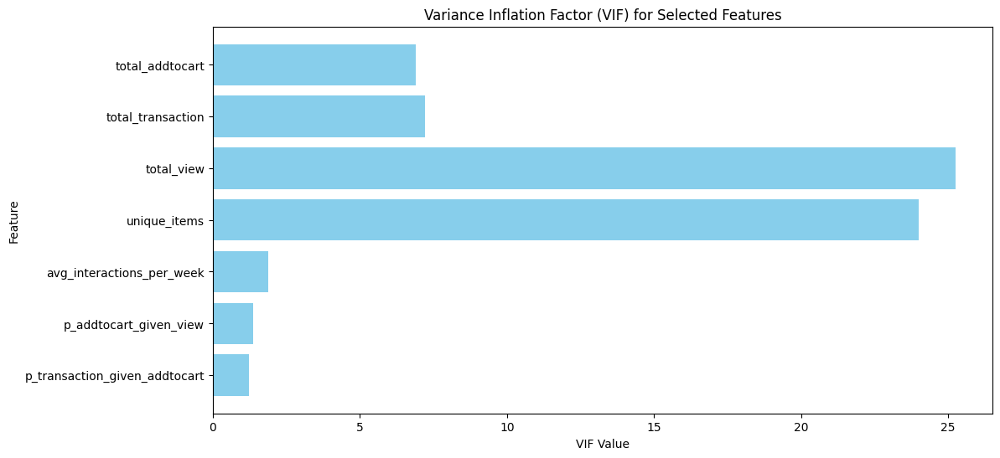

,Feature,VIF
2,total_view,25.243306
3,unique_items,24.012340
1,total_transaction,7.210680
0,total_addtocart,6.904676
4,avg_interactions_per_week,1.883403
5,p_addtocart_given_view,1.358939
6,p_transaction_given_addtocart,1.234865


In [ ]:
users_numeric = users.select_dtypes(include=[np.number])

if 'visitorid' in users_numeric.columns:
    users_numeric = users_numeric.drop(columns=['visitorid'])

# Handle missing and infinite values
users_cleaned = users_numeric.replace([np.inf, -np.inf], np.nan).dropna()

# Function to calculate VIF
def calculate_vif(df):
    vif_data = pd.DataFrame()
    vif_data["Feature"] = df.columns
    vif_data["VIF"] = [sm.OLS(df[col], sm.add_constant(df.drop(columns=[col]))).fit().rsquared for col in df.columns]
    vif_data["VIF"] = 1 / (1 - vif_data["VIF"])
    return vif_data


# Compute VIF
vif_df = calculate_vif(users_cleaned)

# Plot VIF values
plt.figure(figsize=(12, 6))
plt.barh(vif_df["Feature"], vif_df["VIF"], color="skyblue")
plt.xlabel("VIF Value")
plt.ylabel("Feature")
plt.title("Variance Inflation Factor (VIF) for Selected Features")
plt.gca().invert_yaxis()  # Invert y-axis for better readability
plt.show()

# Display VIF values
vif_df.sort_values(by='VIF',ascending=False)


**Variance Inflation Factor (VIF) Analysis of User Interaction Metrics**<br>
This analysis visualizes the multicollinearity among user interaction metrics. High VIF values for **total_view** (25.24) and **unique_items** (24.01) indicate strong collinearity, suggesting that these features may provide redundant information. Moderate VIF values for **total_transaction** (7.21) and **total_addtocart** (6.90) further highlight dependencies among transactional metrics. In contrast, **p_addtocart_given_view** (1.36) and **p_transaction_given_addtocart** (1.23) exhibit low multicollinearity, making them more reliable predictors. Reducing or transforming highly collinear features can improve model interpretability and stability.









### Anomaly Detection
Anomaly Detection has been implemented using 2 broad approaches-
1. Principal Component Analysis
2. Isolation Forest (With and without PCA)

#### PCA
* Performed Principal Component Analysis to see the variance along components and how dimensionality reduction can be implemented. The reconstruction error serves as an anomaly detection metric in this PCA-based approach.

In [ ]:
users.head(3)

,visitorid,total_addtocart,total_transaction,total_view,unique_items,avg_interactions_per_week,p_addtocart_given_view,p_transaction_given_addtocart
0,0,0,0,3,3,3.0,0.0,0.0
1,1,0,0,1,1,1.0,0.0,0.0
2,2,0,0,8,4,8.0,0.0,0.0


* Scaling the data before implementing PCA

In [ ]:
sc = StandardScaler()
normalized_users = sc.fit_transform(users)
normalized_users_df = pd.DataFrame(normalized_users, columns=users.columns.tolist())

* Fitting the model

In [ ]:
# Create the model
model = PCA()

#fit the data
model.fit(normalized_users)

# transform the data
transformed_users = model.transform(normalized_users)
transformed_users_df = pd.DataFrame(transformed_users)

# Rename the columns
transformed_users_df.columns = [f"PC{i+1}" for i in range(users.shape[1])]

transformed_users_df.head(3)

,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8
0,0.267668,-0.178855,-1.732335,0.065301,0.380776,-0.049832,0.020367,-0.072002
1,-0.185641,-0.127123,-1.731832,0.034175,-0.151981,0.012040,0.000381,-0.006291
2,1.138346,-0.238547,-1.733514,0.134317,1.663009,-0.495528,0.082760,0.154015


* Plotting the variance explained by the Principal Components

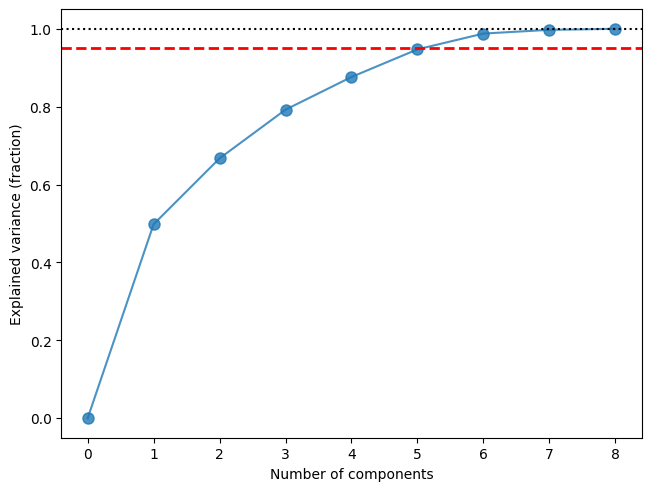

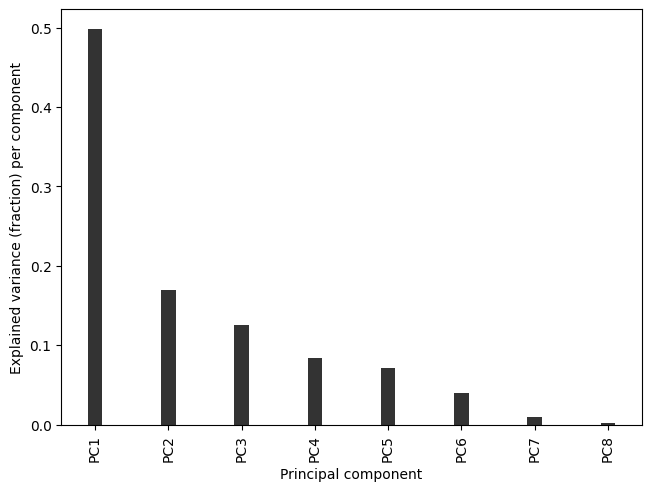

In [ ]:
_, ax = pca_explained_variance(model,  marker='o', markersize=8, alpha=0.8)

# Let's add a line at an explained variance of 90%
ax.axhline(y=0.95, color='r', linestyle='--', linewidth=2)

plt.show()

pca_explained_variance_bar(
    model,
    width=0.2,
    alpha=0.8,
    color='black',
)

plt.show()

**Variance along Principal Components**<br>
This analysis visualizes the explained variance across principal components, highlighting the dimensionality reduction process. The scree plot (top) shows that the first few principal components capture the majority of the variance, with around six components needed to explain nearly 100% of the variability. The bar chart (bottom) illustrates the contribution of each principal component, where PC1 dominates, followed by PC2 and PC3, indicating that most of the variation in user interactions can be represented in a lower-dimensional space. Reducing the number of dimensions while preserving key variance improves computational efficiency and model interpretability.

In [ ]:
transformed_users_df.describe()

,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8
count,1.407580e+06,1.407580e+06,1.407580e+06,1.407580e+06,1.407580e+06,1.407580e+06,1.407580e+06,1.407580e+06
mean,-2.483603e-18,-6.259488e-19,1.679966e-16,1.481076e-17,-1.128727e-17,2.473507e-19,-4.150697e-18,3.972756e-18
std,1.996393e+00,1.163232e+00,1.000004e+00,8.194223e-01,7.533530e-01,5.694899e-01,2.773975e-01,1.450525e-01
min,-1.874503e-01,-9.527150e+01,-1.824511e+00,-1.893259e+02,-3.270060e+02,-1.066283e+02,-1.018069e+02,-3.788100e+01
25%,-1.868129e-01,-1.360762e-01,-8.660691e-01,2.321389e-02,-1.500295e-01,1.209352e-02,1.217525e-04,-6.644808e-03
50%,-1.861756e-01,-1.283726e-01,1.840559e-05,2.870029e-02,-1.480467e-01,1.242236e-02,2.429760e-04,-6.500246e-03
75%,-2.604140e-02,-1.277120e-01,8.659976e-01,3.391104e-02,-2.008798e-03,1.275163e-02,3.640284e-04,-6.355800e-03
max,1.173114e+03,1.926916e+02,2.127522e+00,2.371723e+01,1.521859e+02,1.862066e+02,7.157588e+01,4.244807e+01


* Saving the table PCA reduced dataset for further usage.

In [ ]:
transformed_users_df.to_parquet('pca_transformed_users.parquet')

* Interpreting the Principal Components using components and loadings

In [ ]:
components_df = pd.DataFrame(model.components_, index=[f'PC{i+1}' for i in range(len(model.components_))], columns=normalized_users_df.columns.tolist())

components_df['magnitude'] = components_df.apply(lambda row: np.sqrt(np.sum(row**2)), axis=1)

components_df.head(3)

,visitorid,total_addtocart,total_transaction,total_view,unique_items,avg_interactions_per_week,p_addtocart_given_view,p_transaction_given_addtocart,magnitude
PC1,-0.000522,0.450061,0.452315,0.471835,0.468973,0.378166,0.061101,0.059568,1.0
PC2,-0.000541,0.062748,0.001960,-0.122775,-0.124369,0.008683,0.700238,0.689281,1.0
PC3,0.999987,0.000241,0.001463,0.000127,-0.000118,-0.000785,-0.002902,0.003718,1.0


In [ ]:
loadings = components_df.drop('magnitude', axis=1).mul(np.sqrt(model.explained_variance_), axis=0)

loadings_df = pd.DataFrame(loadings, index=[f'PC{i+1}' for i in range(len(model.components_))], columns=normalized_users_df.columns.tolist())
loadings_df.head(3)

,visitorid,total_addtocart,total_transaction,total_view,unique_items,avg_interactions_per_week,p_addtocart_given_view,p_transaction_given_addtocart
PC1,-0.001043,0.898499,0.902999,0.941968,0.936255,0.754968,0.121982,0.118921
PC2,-0.000629,0.072990,0.002280,-0.142815,-0.144670,0.010100,0.814539,0.801794
PC3,0.999992,0.000241,0.001463,0.000127,-0.000118,-0.000785,-0.002902,0.003718


* Filtering outliers i.e. datapoints which are more than 3 standard deviations after transforming the data on the basis of the reconstruction error.

In [ ]:
# Apply PCA with 7 components
pca_7 = PCA(n_components=7)
transformed_users_7pc = pca_7.fit_transform(normalized_users)

# Reconstruct data
reconstructed_data = pca_7.inverse_transform(transformed_users_7pc)

# Compute Reconstruction Error (Euclidean distance)
reconstruction_error = np.linalg.norm(normalized_users - reconstructed_data, axis=1)

# Compute Mean and Standard Deviation
mean_error = np.mean(reconstruction_error)
std_error = np.std(reconstruction_error)

# Identify Outliers (Error > 3 Standard Deviations)
threshold = mean_error + 3 * std_error

# Convert transformed data back to DataFrame
transformed_users_7pc = pd.DataFrame(transformed_users_7pc, columns=[f'PC{i+1}' for i in range(7)])
transformed_users_7pc['pca_outlier'] = (reconstruction_error > threshold).astype(int)
# Copy the 'pca_outlier' column from transformed_users_7pc to transformed_users_df
transformed_users_df['pca_outlier'] = transformed_users_7pc['pca_outlier']



In [ ]:
users['pca_outlier'] = transformed_users_df['pca_outlier']

In [ ]:
users['pca_outlier'].value_counts()

pca_outlier
0    1400679
1       6901
Name: count, dtype: int64

In [ ]:
users.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1407580 entries, 0 to 1407579
Data columns (total 9 columns):
 #   Column                         Non-Null Count    Dtype  
---  ------                         --------------    -----  
 0   visitorid                      1407580 non-null  int64  
 1   total_addtocart                1407580 non-null  int64  
 2   total_transaction              1407580 non-null  int64  
 3   total_view                     1407580 non-null  int64  
 4   unique_items                   1407580 non-null  int64  
 5   avg_interactions_per_week      1407580 non-null  float64
 6   p_addtocart_given_view         1407580 non-null  float64
 7   p_transaction_given_addtocart  1407580 non-null  float64
 8   pca_outlier                    1407580 non-null  int64  
dtypes: float64(3), int64(6)
memory usage: 96.7 MB


In [ ]:
# Group by 'pca_outlier' and compute the mean of all other columns
means_comparison = users.groupby('pca_outlier').mean()

print(means_comparison)

                 visitorid  total_addtocart  total_transaction  total_view  \
pca_outlier                                                                  
0            703781.588468         0.035844           0.009894    1.690971   
1            705395.284162         2.771482           1.246051   42.864078   

             unique_items  avg_interactions_per_week  p_addtocart_given_view  \
pca_outlier                                                                    
0                1.418019                   1.542961                0.014145   
1               23.038690                  18.007889                0.080093   

             p_transaction_given_addtocart  
pca_outlier                                 
0                                 0.004835  
1                                 0.038493  


In [ ]:
#Need to take a sample because plotly taking too much time
transformed_users_df_sampled = transformed_users_df.sample(n=100000, random_state=142)  # Adjust the number as needed

* Plotting the ouliers against other points.

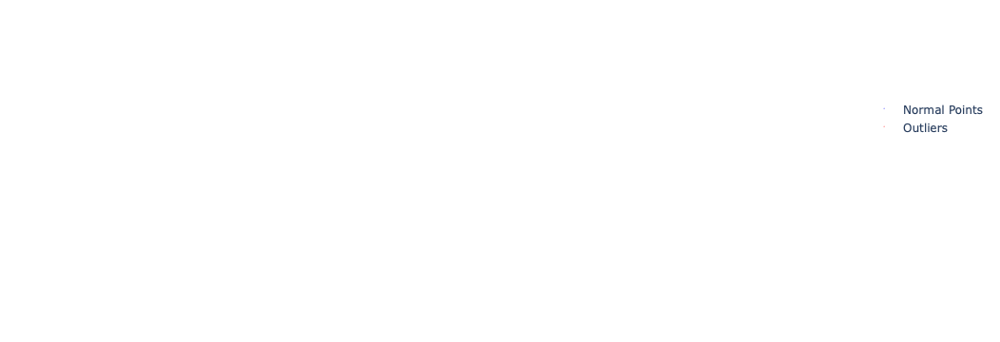

In [ ]:
# Separate outliers in the sampled data
sampled_outliers = transformed_users_df_sampled[transformed_users_df_sampled["pca_outlier"] == 1]
sampled_normal_data = transformed_users_df_sampled[transformed_users_df_sampled["pca_outlier"] == 0]

# Create a 3D scatter plot
fig = go.Figure()

# Add normal points (blue)
fig.add_trace(
    go.Scatter3d(
        x=sampled_normal_data["PC1"],
        y=sampled_normal_data["PC2"],
        z=sampled_normal_data["PC3"],
        mode="markers",
        marker=dict(size=2, opacity=0.3, color="blue"),
        name="Normal Points",
    )
)

# Add outliers (red)
fig.add_trace(
    go.Scatter3d(
        x=sampled_outliers["PC1"],
        y=sampled_outliers["PC2"],
        z=sampled_outliers["PC3"],
        mode="markers",
        marker=dict(size=2, opacity=0.3, color="red"),
        name="Outliers",
    )
)

# Show the plot
fig.show()


* Saving the dataset with anomalies marekd as a separate file for further usage

In [ ]:
users.to_parquet('users_w_outliers.parquet')

#### Isolation Forest
* Implemented an anaomaly detection method, isolation forest for marking anomaly. For Isolation Forest, the Anomaly Score (decision function) and Outlier Label (-1 for outliers) are used.

##### Contamination = Auto
* Carried out Isolation Forest with the contamination set to auto wich is actually 0.1 by default.

In [ ]:
scaler = StandardScaler()
users_normalized = pd.DataFrame(scaler.fit_transform(users), columns=users.columns)


In [ ]:
# Train an Isolation Forest model
iso_forest = IsolationForest(n_estimators=100, contamination='auto', random_state=42)
users_normalized["anomaly_score"] = iso_forest.fit_predict(users_normalized)

users_normalized["anomaly_score"].value_counts()
users_cleaned['anomaly_score_auto']=users_normalized["anomaly_score"]

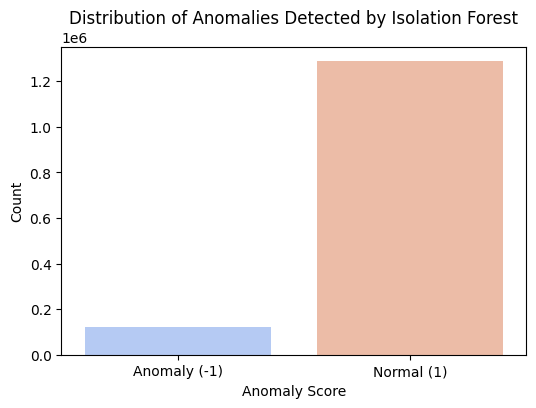

In [ ]:
# Count anomalies and normal points
anomaly_counts = users_normalized["anomaly_score"].value_counts()

# Plot anomaly distribution with count labels
plt.figure(figsize=(6, 4))
ax = sns.barplot(x=anomaly_counts.index, y=anomaly_counts.values, palette="coolwarm")
plt.xticks(ticks=[0, 1], labels=["Anomaly (-1)","Normal (1)"])
plt.xlabel("Anomaly Score")
plt.ylabel("Count")
plt.title("Distribution of Anomalies Detected by Isolation Forest")


plt.show()


**Distribution of Anomalies Detected by Isolation Forest**<br>
This visualization shows the classification of data points as normal (1) or anomalous (-1) based on Isolation Forest. About 10% of the points are detected as anomalies, indicating potential outliers in the dataset that differ significantly from the majority of observations.

In [ ]:
# Extract anomalies for visualization
anomalies = users_normalized[users_normalized["anomaly_score"] == -1]
anomaly_summary = {
    "Total Data Points": len(users_normalized),
    "Total Anomalies Detected": len(anomalies),
    "Percentage of Anomalies": round(len(anomalies) / len(users_normalized) * 100, 2)
}

# Show anomaly summary
anomaly_summary

{'Total Data Points': 1407580,
 'Total Anomalies Detected': 128698,
 'Percentage of Anomalies': 9.14}

In [ ]:
# Get anomaly labels (-1 = anomaly, 1 = normal)
anomaly_labels = iso_forest.predict(users_normalized)

# Compute actual contamination level
actual_contamination = (anomaly_labels == -1).sum() / len(anomaly_labels)
print(f"Actual Contamination Level: {actual_contamination:.4%}")

Actual Contamination Level: 9.1432%


* Since the number of points of anomalies marked are higher, isolation forest also implemented with contamination=0.05

##### Contamination = 0.05

In [ ]:
# Train an Isolation Forest model
iso_forest = IsolationForest(n_estimators=100, contamination=0.05, random_state=42)
users_normalized["anomaly_score"] = iso_forest.fit_predict(users_normalized)

users_normalized["anomaly_score"].value_counts()
users_cleaned['anomaly_score']=users_normalized["anomaly_score"]


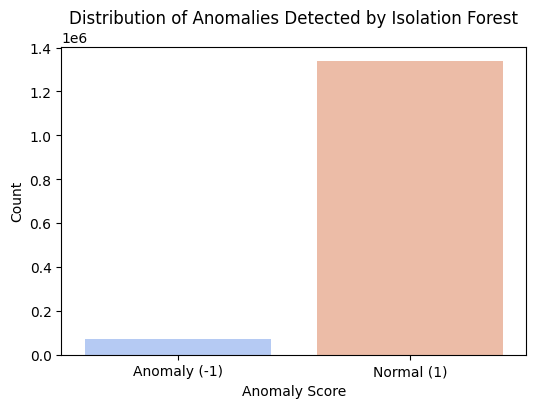

In [ ]:
# Count anomalies and normal points
anomaly_counts = users_normalized["anomaly_score"].value_counts()

# Plot anomaly distribution with count labels
plt.figure(figsize=(6, 4))
ax = sns.barplot(x=anomaly_counts.index, y=anomaly_counts.values, palette="coolwarm")
plt.xticks(ticks=[0, 1], labels=["Anomaly (-1)","Normal (1)"])
plt.xlabel("Anomaly Score")
plt.ylabel("Count")
plt.title("Distribution of Anomalies Detected by Isolation Forest")


plt.show()




In [ ]:
# Extract anomalies for visualization
anomalies = users_normalized[users_normalized["anomaly_score"] == -1]
anomaly_summary = {
    "Total Data Points": len(users_normalized),
    "Total Anomalies Detected": len(anomalies),
    "Percentage of Anomalies": round(len(anomalies) / len(users_normalized) * 100, 2)
}

# Show anomaly summary
anomaly_summary

{'Total Data Points': 1407580,
 'Total Anomalies Detected': 69910,
 'Percentage of Anomalies': 4.97}

#### Isolation Forest with PCA

* To further improve results, PCA was implemented prior to ISolation Forest

In [ ]:
test = users.copy()

In [ ]:
# Train an Isolation Forest model
iso_forest = IsolationForest(n_estimators=200, contamination= 0.05, random_state=42)
test["anomaly_score"] = iso_forest.fit_predict(transformed_users_7pc)

test["anomaly_score"].value_counts()

anomaly_score
 1    1337201
-1      70379
Name: count, dtype: int64

In [ ]:
# Extract anomalies for visualization
anomalies = test[test["anomaly_score"] == -1]
anomaly_summary = {
    "Total Data Points": len(test),
    "Total Anomalies Detected": len(anomalies),
    "Percentage of Anomalies": round(len(anomalies) / len(test) * 100, 2)
}

# Show anomaly summary
anomaly_summary

{'Total Data Points': 1407580,
 'Total Anomalies Detected': 70379,
 'Percentage of Anomalies': 5.0}

In [ ]:
#Creating the outlier column similar to the one done in PCA
test['pca_outlier'] = test['anomaly_score'].apply(lambda x: 0 if x == 1 else (1 if x == -1 else 0))
test.head()

,visitorid,total_addtocart,total_transaction,total_view,unique_items,avg_interactions_per_week,p_addtocart_given_view,p_transaction_given_addtocart,pca_outlier,anomaly_score
0,0,0,0,3,3,3.0,0.0,0.0,0,1
1,1,0,0,1,1,1.0,0.0,0.0,0,1
2,2,0,0,8,4,8.0,0.0,0.0,1,-1
3,3,0,0,1,1,1.0,0.0,0.0,0,1
4,4,0,0,1,1,1.0,0.0,0.0,0,1


In [ ]:
users['iso_pca_outlier'] = test['pca_outlier']
users.head(3)

,visitorid,total_addtocart,total_transaction,total_view,unique_items,avg_interactions_per_week,p_addtocart_given_view,p_transaction_given_addtocart,pca_outlier,iso_pca_outlier
0,0,0,0,3,3,3.0,0.0,0.0,0,0
1,1,0,0,1,1,1.0,0.0,0.0,0,0
2,2,0,0,8,4,8.0,0.0,0.0,0,1


In [ ]:
transformed_users_df['iso_pca_outlier'] = test['pca_outlier']

In [ ]:
#Need to take a sample because plotly taking too much time
transformed_users_df_sampled = transformed_users_df.sample(n=100000, random_state=142)  # Adjust the number as needed

* Plotting the anomalies against others when Isolation FOrest was implemented after PCA.

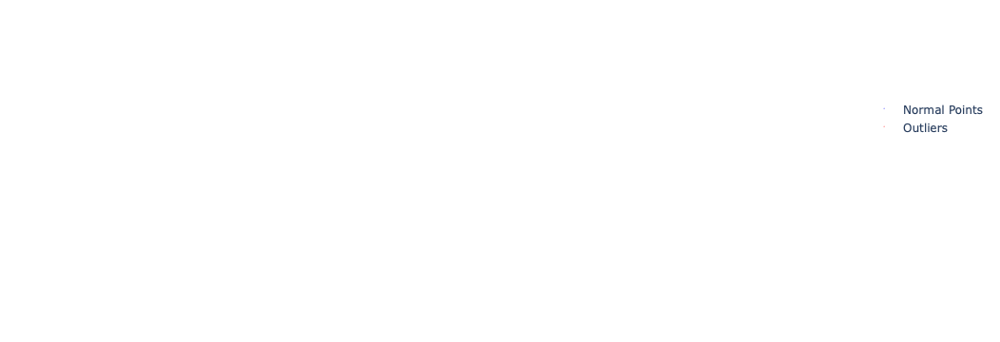

In [ ]:
import plotly.graph_objects as go

# Separate outliers in the sampled data
sampled_outliers = transformed_users_df_sampled[transformed_users_df_sampled["iso_pca_outlier"] == 1]
sampled_normal_data = transformed_users_df_sampled[transformed_users_df_sampled["iso_pca_outlier"] == 0]

# Create a 3D scatter plot
fig = go.Figure()

# Add normal points (blue)
fig.add_trace(
    go.Scatter3d(
        x=sampled_normal_data["PC1"],
        y=sampled_normal_data["PC2"],
        z=sampled_normal_data["PC3"],
        mode="markers",
        marker=dict(size=2, opacity=0.3, color="blue"),
        name="Normal Points",
    )
)

# Add outliers (red)
fig.add_trace(
    go.Scatter3d(
        x=sampled_outliers["PC1"],
        y=sampled_outliers["PC2"],
        z=sampled_outliers["PC3"],
        mode="markers",
        marker=dict(size=2, opacity=0.3, color="red"),
        name="Outliers",
    )
)

# Show the plot
fig.show()


In [ ]:
outliers_df_pca.head()

,visitorid,total_addtocart,total_transaction,total_view,unique_items,avg_interactions_per_week,p_addtocart_given_view,p_transaction_given_addtocart,pca_outlier,iso_pca_outlier
75,75,0,0,26,2,6.5,0.000000,0.0,1,1
155,155,7,0,7,13,3.5,0.538462,0.0,1,1
224,224,0,0,12,3,12.0,0.000000,0.0,1,1
270,270,0,0,13,1,6.5,0.000000,0.0,1,1
420,420,8,0,6,8,14.0,0.812500,0.0,1,1


### Comparing outliers detected through Isolation Forest and PCA

* Ouliers from PCA

In [ ]:
outliers_df_pca = users[users['pca_outlier'] == 1]
non_outliers_df_pca = users[users['pca_outlier'] == 0]

users_columns = [
    'total_addtocart', 'total_transaction', 'total_view', 'unique_items',
    'p_addtocart_given_view', 'p_transaction_given_addtocart', 'avg_interactions_per_week'
]

outliers_mean_pca = outliers_df_pca[users_columns].mean()
non_outliers_mean_pca = non_outliers_df_pca[users_columns].mean()

comparison_df_pca = pd.DataFrame({
    'Outliers (PCA)': outliers_mean_pca,
    'Non-Outliers (PCA)': non_outliers_mean_pca
})

print("PCA Outliers vs Non-Outliers Comparison")
print(comparison_df_pca)

PCA Outliers vs Non-Outliers Comparison
                               Outliers (PCA)  Non-Outliers (PCA)
total_addtocart                      2.771482            0.035844
total_transaction                    1.246051            0.009894
total_view                          42.864078            1.690971
unique_items                        23.038690            1.418019
p_addtocart_given_view               0.080093            0.014145
p_transaction_given_addtocart        0.038493            0.004835
avg_interactions_per_week           18.007889            1.542961


* Outliers from Isolation Forest

In [ ]:
outliers_df_iso = users[users['iso_pca_outlier'] == 1]
non_outliers_df_iso = users[users['iso_pca_outlier'] == 0]

users_columns = [
    'total_addtocart', 'total_transaction', 'total_view', 'unique_items',
    'p_addtocart_given_view', 'p_transaction_given_addtocart', 'avg_interactions_per_week'
]

outliers_mean_iso = outliers_df_iso[users_columns].mean()
non_outliers_mean_iso = non_outliers_df_iso[users_columns].mean()

comparison_df_iso = pd.DataFrame({
    'Outliers (ISO)': outliers_mean_iso,
    'Non-Outliers (ISO)': non_outliers_mean_iso
})

print("Isolation Forest Outliers vs Non-Outliers Comparison")
print(comparison_df_iso)

Isolation Forest Outliers vs Non-Outliers Comparison
                               Outliers (ISO)  Non-Outliers (ISO)
total_addtocart                      0.985123            0.000000
total_transaction                    0.319087            0.000000
total_view                          10.360235            1.447179
unique_items                         6.471717            1.263614
p_addtocart_given_view               0.289360            0.000000
p_transaction_given_addtocart        0.099998            0.000000
avg_interactions_per_week            7.149012            1.332878


* Comparing the outliers

In [ ]:
comparison_df = pd.DataFrame({
    'Outliers (PCA)': outliers_mean_pca,
    'Outliers (ISO)': outliers_mean_iso
})

print("PCA Outliers vs Isolation Forest Outliers")
print(comparison_df)

PCA Outliers vs Isolation Forest Outliers
                               Outliers (PCA)  Outliers (ISO)
total_addtocart                      2.771482        0.985123
total_transaction                    1.246051        0.319087
total_view                          42.864078       10.360235
unique_items                        23.038690        6.471717
p_addtocart_given_view               0.080093        0.289360
p_transaction_given_addtocart        0.038493        0.099998
avg_interactions_per_week           18.007889        7.149012


* Filtering the datapoints which were outliers for both PCA and Isolation Forest and assessing the resulting dataframe.

In [ ]:
users['anomaly'] = ((users['pca_outlier'] == 1) & (users['iso_pca_outlier'] == 1)).astype(int)
users.head()

,visitorid,total_addtocart,total_transaction,total_view,unique_items,avg_interactions_per_week,p_addtocart_given_view,p_transaction_given_addtocart,pca_outlier,iso_pca_outlier,anomaly
0,0,0,0,3,3,3.0,0.0,0.0,0,0,0
1,1,0,0,1,1,1.0,0.0,0.0,0,0,0
2,2,0,0,8,4,8.0,0.0,0.0,0,1,0
3,3,0,0,1,1,1.0,0.0,0.0,0,0,0
4,4,0,0,1,1,1.0,0.0,0.0,0,0,0


In [ ]:
is_anomaly = users[users['anomaly'] == 1]
is_not_anomaly = users[users['anomaly'] == 0]

users_columns = [
    'total_addtocart', 'total_transaction', 'total_view', 'unique_items',
    'p_addtocart_given_view', 'p_transaction_given_addtocart', 'avg_interactions_per_week'
]

is_anomaly_mean = is_anomaly[users_columns].mean()
is_not_anomaly_mean = is_not_anomaly[users_columns].mean()

comparison_df_anomalies = pd.DataFrame({
    'Anomalies': is_anomaly_mean,
    'Non Anomalies': is_not_anomaly_mean
})

print("Anomalies vs Non Anomalies Comparison")
print(comparison_df_anomalies)

Anomalies vs Non Anomalies Comparison
                               Anomalies  Non Anomalies
total_addtocart                 2.773090       0.035844
total_transaction               1.246774       0.009894
total_view                     42.883718       1.690991
unique_items                   23.051472       1.418017
p_addtocart_given_view          0.080140       0.014145
p_transaction_given_addtocart   0.038515       0.004835
avg_interactions_per_week      18.016810       1.542964


In [ ]:
users['anomaly'].value_counts()

anomaly
0    1400683
1       6897
Name: count, dtype: int64

In [ ]:
users.head()

,visitorid,total_addtocart,total_transaction,total_view,unique_items,avg_interactions_per_week,p_addtocart_given_view,p_transaction_given_addtocart,pca_outlier,iso_pca_outlier,anomaly
0,0,0,0,3,3,3.0,0.0,0.0,0,0,0
1,1,0,0,1,1,1.0,0.0,0.0,0,0,0
2,2,0,0,8,4,8.0,0.0,0.0,0,1,0
3,3,0,0,1,1,1.0,0.0,0.0,0,0,0
4,4,0,0,1,1,1.0,0.0,0.0,0,0,0


In [ ]:
users_wo_outliers = users[users['anomaly']==0]
users_wo_outliers.head(3)

,visitorid,total_addtocart,total_transaction,total_view,unique_items,avg_interactions_per_week,p_addtocart_given_view,p_transaction_given_addtocart,pca_outlier,iso_pca_outlier,anomaly
0,0,0,0,3,3,3.0,0.0,0.0,0,0,0
1,1,0,0,1,1,1.0,0.0,0.0,0,0,0
2,2,0,0,8,4,8.0,0.0,0.0,0,1,0


In [ ]:
users_w_outliers = users[users['anomaly']==1]
users_w_outliers.head(3)

,visitorid,total_addtocart,total_transaction,total_view,unique_items,avg_interactions_per_week,p_addtocart_given_view,p_transaction_given_addtocart,pca_outlier,iso_pca_outlier,anomaly
75,75,0,0,26,2,6.5,0.000000,0.0,1,1,1
155,155,7,0,7,13,3.5,0.538462,0.0,1,1,1
224,224,0,0,12,3,12.0,0.000000,0.0,1,1,1


* Saving the anomalies in `user_anomalies.parquet` and the filtered dataset without the outliers in `users_without_outliers.parquet` for downstream usage.

In [ ]:
users_wo_outliers.to_parquet("users_without_outliers.parquet")

In [ ]:
users_w_outliers.to_parquet("user_anomalies.parquet")